In [1]:
import os

# List files in the '/kaggle/input/' directory to find your uploaded zip file
for dirname, _, filenames in os.walk('/kaggle/input/'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/signatures/6.jpg
/kaggle/input/signatures/5.jpg
/kaggle/input/signatures/8.jpg
/kaggle/input/signatures/10.jpg
/kaggle/input/signatures/9.jpg
/kaggle/input/signatures/1.jpg
/kaggle/input/signatures/16.jpg
/kaggle/input/signatures/7.jpg
/kaggle/input/signatures/13.jpg
/kaggle/input/signatures/15.jpg
/kaggle/input/signatures/12.jpg
/kaggle/input/signatures/11.jpg
/kaggle/input/signatures/4.jpg
/kaggle/input/signatures/3.jpg
/kaggle/input/signatures/14.jpg
/kaggle/input/signatures/2.jpg


Converted 16 images to grayscale successfully!


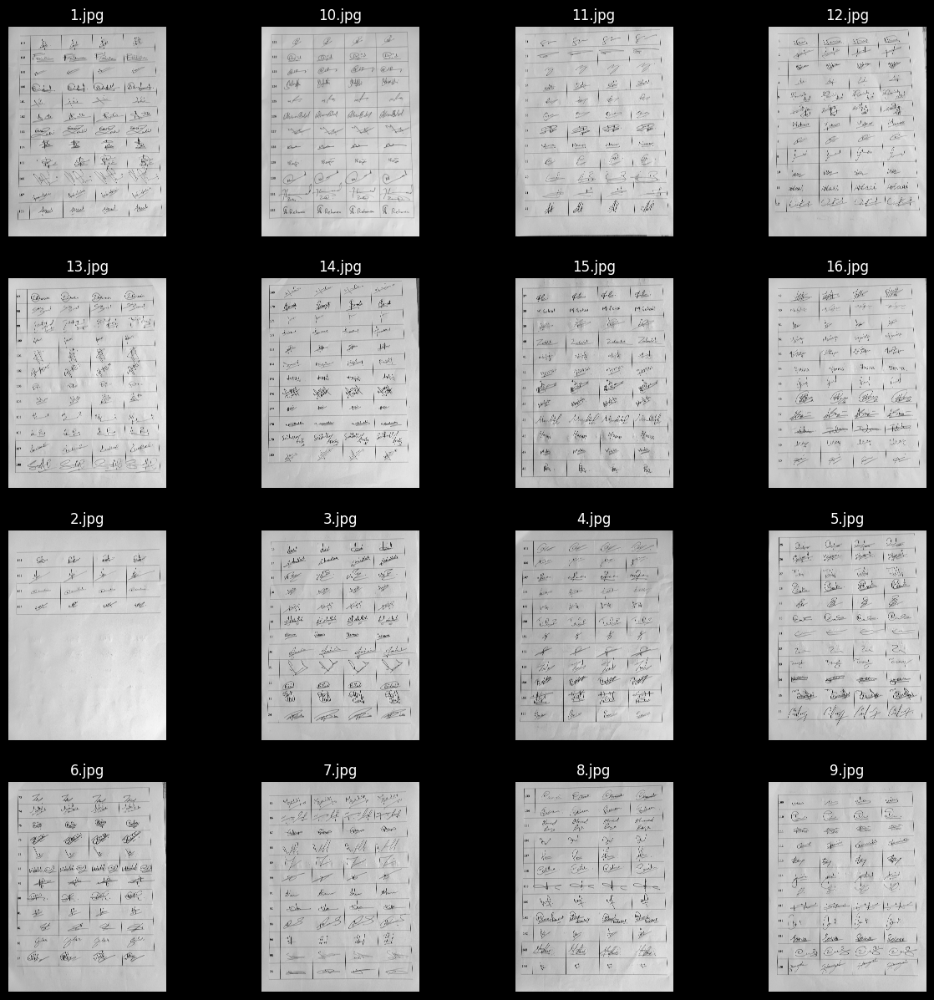

In [2]:
import os
import matplotlib.pyplot as plt
import cv2

# Set the directory where your images are located
input_dir = '/kaggle/input/signatures/'
output_dir = '/kaggle/working/renamed_signatures/'
os.makedirs(output_dir, exist_ok=True)

# Get the list of image files
image_files = [f for f in os.listdir(input_dir) if f.endswith('.jpg') or f.endswith('.png')]

# Function to convert images to grayscale and save them
def convert_to_grayscale(image_files, output_dir, input_dir):
    for image_file in image_files:
        old_path = os.path.join(input_dir, image_file)
        new_path = os.path.join(output_dir, image_file)  # Save with the same name

        # Read the image
        img = cv2.imread(old_path)
        # Convert to grayscale
        img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        # Save the grayscale image
        cv2.imwrite(new_path, img_gray)

    print(f"Converted {len(image_files)} images to grayscale successfully!")

# Function to display the grayscale images
def display_images(output_dir):
    grayscale_files = sorted([f for f in os.listdir(output_dir) if f.endswith('.jpg') or f.endswith('.png')])

    # Create a figure with a black background
    plt.figure(figsize=(15, 15), facecolor='black')

    # Display each image in a grid
    for i, image_file in enumerate(grayscale_files):
        image_path = os.path.join(output_dir, image_file)
        img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Read the grayscale image

        # Plot the image
        plt.subplot(4, 4, i + 1)  # Adjust grid size as needed
        plt.imshow(img, cmap='gray')  # Display in grayscale
        plt.title(image_file, color='white')  # Set title color to white for better visibility
        plt.axis('off')
        plt.gca().set_facecolor('black')  # Set axis background color to black

    plt.show()

# Execute the functions
convert_to_grayscale(image_files, output_dir, input_dir)
display_images(output_dir)


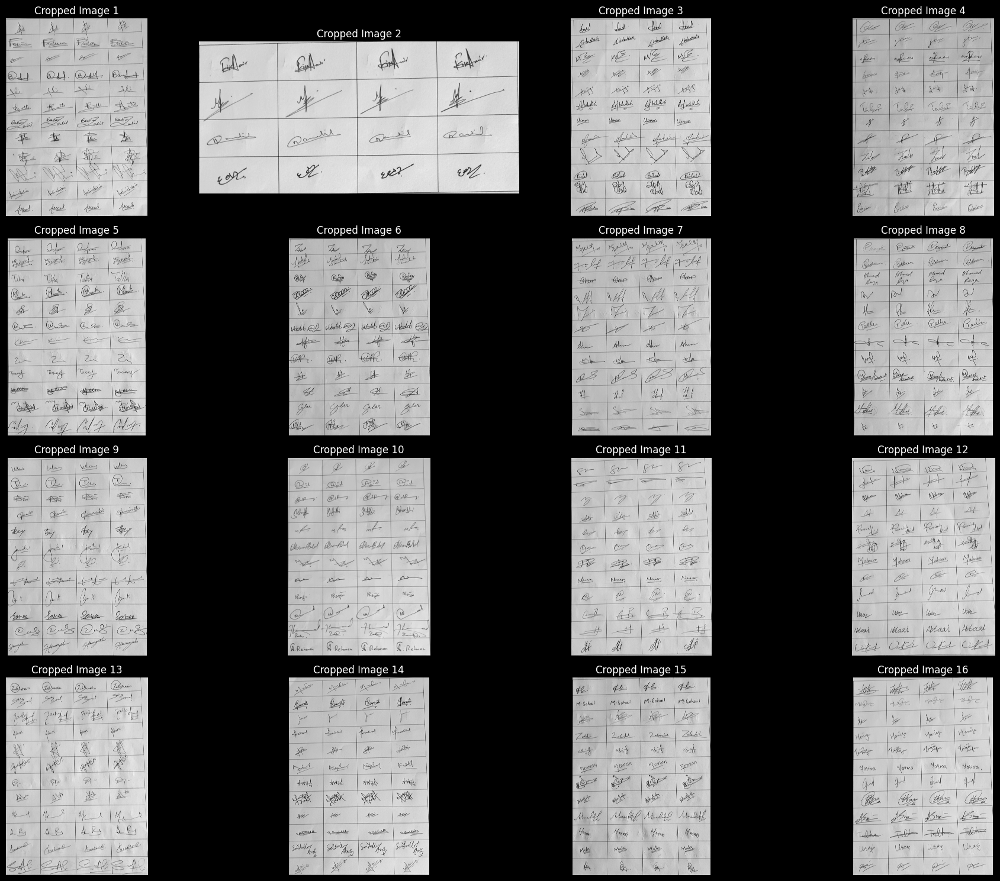

In [3]:
import cv2
import matplotlib.pyplot as plt
import os  # Import os module to handle directories

# Function to crop an image
def crop_image(image_path, top, bottom, left, right):
    # Load the grayscale image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Calculate the height and width of the original image
    height, width = image.shape

    # Crop the image
    cropped_image = image[top:height - bottom, left:width - right]
    return cropped_image

# Step 1: Define the paths for all images in the Kaggle environment
image_paths = [
    '/kaggle/input/signatures/1.jpg',  # Image 1
    '/kaggle/input/signatures/2.jpg',  # Image 2
    '/kaggle/input/signatures/3.jpg',  # Image 3
    '/kaggle/input/signatures/4.jpg',  # Image 4
    '/kaggle/input/signatures/5.jpg',  # Image 5
    '/kaggle/input/signatures/6.jpg',  # Image 6
    '/kaggle/input/signatures/7.jpg',  # Image 7
    '/kaggle/input/signatures/8.jpg',  # Image 8
    '/kaggle/input/signatures/9.jpg',  # Image 9
    '/kaggle/input/signatures/10.jpg',  # Image 10
    '/kaggle/input/signatures/11.jpg',  # Image 11
    '/kaggle/input/signatures/12.jpg',  # Image 12
    '/kaggle/input/signatures/13.jpg',  # Image 13
    '/kaggle/input/signatures/14.jpg',  # Image 14
    '/kaggle/input/signatures/15.jpg',  # Image 15
    '/kaggle/input/signatures/16.jpg',  # Image 16
]

# Define the cropping parameters for each image (top, bottom, left, right)
crop_parameters = [
    (340, 750, 830, 240),  # Image 1
    (800, 12800, 730, 220),  # Image 2
    (400, 650, 670, 400),   # Image 3
    (400, 680, 550, 500),   # Image 4
    (200, 700, 750, 300),   # Image 5
    (300, 970, 720, 500),   # Image 6
    (430, 500, 690, 350),   # Image 7
    (230, 650, 650, 350),   # Image 8
    (450, 630, 750, 400),   # Image 9
    (130, 350, 370, 100),   # Image 10
    (180, 750, 750, 250),    # Image 11
    (200, 950, 700, 350),    # Image 12
    (400, 550, 700, 250),    # Image 13
    (150, 950, 670, 450),     # Image 14
    (330, 450, 680, 300),     # Image 15
    (300, 750, 750, 350),     # Image 16
]

# Step 2: Crop all images
cropped_images = []
for index in range(len(image_paths)):
    cropped_images.append(crop_image(image_paths[index], *crop_parameters[index]))

# Step 3: Create directory for cropped images if it doesn't exist
output_dir = '/kaggle/working/cropped_images'
os.makedirs(output_dir, exist_ok=True)

# Step 4: Save all cropped images
for i, cropped_image in enumerate(cropped_images):
    output_path = os.path.join(output_dir, f'cropped_image_{i + 1}.jpg')
    cv2.imwrite(output_path, cropped_image)

# Optional: Display all cropped images
num_images = len(cropped_images)
cols = 4  # Number of columns for the grid layout
rows = (num_images + cols - 1) // cols  # Calculate the number of rows needed

plt.figure(figsize=(20, 15), facecolor='black')  # Adjust figure size as needed

for i in range(num_images):
    plt.subplot(rows, cols, i + 1)  # Create subplot for each image
    plt.imshow(cropped_images[i], cmap='gray')
    plt.title(f"Cropped Image {i + 1}", color='white')
    plt.axis('off')
    plt.gca().set_facecolor('black')  # Set axis background color to black

plt.tight_layout()
plt.show()

Total cropped rows saved: 183
Total images saved in '/kaggle/working/cropped_rows': 183


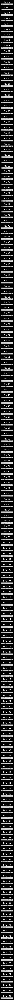

In [4]:
import cv2
import os
import matplotlib.pyplot as plt

# Function to split an image into rows
def split_into_rows(image, avg_row_height):
    height, width = image.shape
    rows = []

    # Loop through the image and split into rows
    for i in range(0, height, avg_row_height):
        row = image[i:i + avg_row_height, :]
        if row.size > 0:  # Check if the row is not empty
            rows.append(row)

    return rows

# Step 1: Load the cropped images from the /kaggle/working/ directory
cropped_image_paths = [
    '/kaggle/working/cropped_images/cropped_image_1.jpg',  # Adjust this path based on where cropped images are stored
    '/kaggle/working/cropped_images/cropped_image_2.jpg',  # Repeat for other images
    '/kaggle/working/cropped_images/cropped_image_3.jpg',
    '/kaggle/working/cropped_images/cropped_image_4.jpg',
    '/kaggle/working/cropped_images/cropped_image_5.jpg',
    '/kaggle/working/cropped_images/cropped_image_6.jpg',
    '/kaggle/working/cropped_images/cropped_image_7.jpg',
    '/kaggle/working/cropped_images/cropped_image_8.jpg',
    '/kaggle/working/cropped_images/cropped_image_9.jpg',
    '/kaggle/working/cropped_images/cropped_image_10.jpg',
    '/kaggle/working/cropped_images/cropped_image_11.jpg',
    '/kaggle/working/cropped_images/cropped_image_12.jpg',
    '/kaggle/working/cropped_images/cropped_image_13.jpg',
    '/kaggle/working/cropped_images/cropped_image_14.jpg',
    '/kaggle/working/cropped_images/cropped_image_15.jpg',
    '/kaggle/working/cropped_images/cropped_image_16.jpg'  # Adjust as needed
]

# Load images in grayscale
cropped_images = [cv2.imread(path, cv2.IMREAD_GRAYSCALE) for path in cropped_image_paths]

# Step 2: Split cropped images with their respective average row heights
avg_row_heights = [570, 600, 570, 600, 580, 550, 590, 585, 570, 290, 580, 558, 575, 572, 593, 580]
rows_images = [split_into_rows(cropped_images[i], avg_row_heights[i]) for i in range(len(cropped_images))]

# Step 3: Drop the last row of each image except for images 2, 7, and 16
for i in range(len(rows_images)):
    if i not in [1, 6, 15]:  # Indices for images 2, 7, and 16
        if rows_images[i]:  # Check if there are rows to drop
            rows_images[i].pop()  # Drop the last row

# Step 4: Create a directory to store cropped rows in Kaggle's working directory
output_folder = '/kaggle/working/cropped_rows'
os.makedirs(output_folder, exist_ok=True)

# Step 5: Save cropped rows to the specified directory
student_counter = 1  # Initialize a counter for naming
for img_index, rows in enumerate(rows_images):
    for row_index, row in enumerate(rows):
        # Construct the filename for the row as student1, student2, ...
        filename = f"student{student_counter}.jpg"
        student_counter += 1  # Increment counter for the next student
        # Save the row image
        cv2.imwrite(os.path.join(output_folder, filename), row)

# Step 6: Count the total number of saved cropped rows
total_cropped_rows = sum(len(rows) for rows in rows_images)
print(f"Total cropped rows saved: {total_cropped_rows}")

# Step 7: Count the number of images saved in the cropped_rows folder
saved_images_count = len(os.listdir(output_folder))
print(f"Total images saved in '{output_folder}': {saved_images_count}")

# Step 8: Display all saved cropped rows
plt.figure(figsize=(10, total_cropped_rows * 0.5), facecolor='black')  # Adjust figure size as needed

for i in range(1, saved_images_count + 1):  # Loop through saved images
    img_path = os.path.join(output_folder, f"student{i}.jpg")
    row_image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    plt.subplot(total_cropped_rows, 1, i)  # Create a subplot for each row
    plt.imshow(row_image, cmap='gray')  # Display the row image
    plt.title(f"Row {i}", color='white')
    plt.axis('off')
    plt.gca().set_facecolor('black')  # Set axis background color to black

# Show all the saved rows
plt.tight_layout()
plt.show()

Folder not found: /kaggle/working/segmented_signatures
Processed and saved columns for row_1.
Processed and saved columns for row_2.
Processed and saved columns for row_3.
Processed and saved columns for row_4.
Processed and saved columns for row_5.
Processed and saved columns for row_6.
Processed and saved columns for row_7.
Processed and saved columns for row_8.
Processed and saved columns for row_9.
Processed and saved columns for row_10.
Processed and saved columns for row_11.
Processed and saved columns for row_12.
Processed and saved columns for row_13.
Processed and saved columns for row_14.
Processed and saved columns for row_15.
Processed and saved columns for row_16.
Processed and saved columns for row_17.
Processed and saved columns for row_18.
Processed and saved columns for row_19.
Processed and saved columns for row_20.
Processed and saved columns for row_21.
Processed and saved columns for row_22.
Processed and saved columns for row_23.
Processed and saved columns for ro

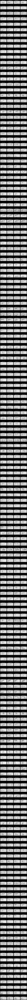

In [5]:
import cv2
import os
import shutil
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Delete previously created segmented signatures folder
segmented_signatures_folder = '/kaggle/working/segmented_signatures'

# Check if the folder exists
if os.path.exists(segmented_signatures_folder):
    # Delete the folder and all its contents
    shutil.rmtree(segmented_signatures_folder)
    print(f"Deleted folder: {segmented_signatures_folder}")
else:
    print(f"Folder not found: {segmented_signatures_folder}")

# Function to split a row into 4 equal columns
def split_into_columns(row_image):
    height, width = row_image.shape
    columns = []

    # Calculate the width of each column by dividing the image width by 4
    avg_col_width = width // 4

    # Loop through the row image and split into 4 equal columns
    for i in range(0, 4):
        start_col = i * avg_col_width
        end_col = start_col + avg_col_width if i < 3 else width  # Last column takes the remaining width
        column = row_image[:, start_col:end_col]
        columns.append(column)

    return columns

# Path to the folder containing cropped rows
output_folder = '/kaggle/working/cropped_rows'
student_images = [f for f in os.listdir(output_folder) if f.startswith('student') and f.endswith('.jpg')]

# Create the segmented_signatures folder if it doesn't exist
if not os.path.exists(segmented_signatures_folder):
    os.makedirs(segmented_signatures_folder)

# Process each row in the cropped_rows folder
for row_index, image_file in enumerate(student_images):
    # Load the row image
    row_image_path = os.path.join(output_folder, image_file)
    row_image = cv2.imread(row_image_path, cv2.IMREAD_GRAYSCALE)

    if row_image is None:
        print(f"Image {row_image_path} could not be loaded.")
        continue

    # Split the row image into 4 equal columns
    columns = split_into_columns(row_image)

    # Create a folder for the current row in segmented_signatures
    row_folder_name = f'row_{row_index + 1}'
    row_folder_path = os.path.join(segmented_signatures_folder, row_folder_name)

    if not os.path.exists(row_folder_path):
        os.makedirs(row_folder_path)

    # Save each column (signature) as an image in the current row folder
    for col_index, column in enumerate(columns):
        column_image_name = f'col_{col_index + 1}.jpg'
        column_image_path = os.path.join(row_folder_path, column_image_name)

        # Save the column image
        cv2.imwrite(column_image_path, column)

    print(f"Processed and saved columns for {row_folder_name}.")

print("Segmentation and saving complete.")

# Step 2: Display all segmented signatures with a black background
plt.figure(figsize=(10, len(student_images) * 2), facecolor='black')  # Adjust figure size as needed

for row_index in range(len(student_images)):
    row_folder_path = os.path.join(segmented_signatures_folder, f'row_{row_index + 1}')
    column_images = [f for f in os.listdir(row_folder_path) if f.endswith('.jpg')]

    for col_index, column_image_file in enumerate(column_images):
        column_image_path = os.path.join(row_folder_path, column_image_file)
        column_image = cv2.imread(column_image_path, cv2.IMREAD_GRAYSCALE)

        if column_image is not None:
            # Create a black background with the same size as the column image
            black_background = 255 * np.ones_like(column_image)  # White (255) for a black background in Grayscale
            
            # Overlay the column image on the black background
            plt.subplot(len(student_images), 4, row_index * 4 + col_index + 1)  # Adjust subplot index
            plt.imshow(column_image, cmap='gray')
            plt.title(f"Row {row_index + 1}, Col {col_index + 1}", color='white')
            plt.axis('off')
            plt.gca().set_facecolor('black')  # Set axis background color to black

# Show all the saved columns
plt.tight_layout()
plt.show()

Total images loaded: 732
Total augmented images: 732


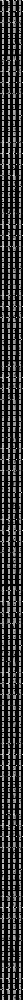

In [6]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Define the valid image extensions
valid_extensions = ['.jpg', '.jpeg', '.png']

# Initialize counters
total_loaded = 0
total_augmented = 0

# Specify the base path where your row folders are located
base_path = '/kaggle/working/segmented_signatures/'  # Update this to your base folder path

# Define an augmentation function
def augment_image(image):
    # Randomly choose to rotate 90 degrees clockwise or counterclockwise
    if np.random.rand() > 0.5:
        rotated_image = cv2.rotate(image, cv2.ROTATE_90_CLOCKWISE)  # Rotate 90 degrees clockwise
    else:
        rotated_image = cv2.rotate(image, cv2.ROTATE_90_COUNTERCLOCKWISE)  # Rotate 90 degrees counterclockwise

    # Random horizontal flip
    if np.random.rand() > 0.5:
        rotated_image = cv2.flip(rotated_image, 1)  # Flip horizontally

    return rotated_image

# Loop through each row folder
for folder in os.listdir(base_path):
    folder_path = os.path.join(base_path, folder)
    
    # Check if it is a directory
    if os.path.isdir(folder_path):
        for filename in os.listdir(folder_path):
            # Check for valid image extensions
            if any(filename.lower().endswith(ext) for ext in valid_extensions):
                img_path = os.path.join(folder_path, filename)
                
                # Load the image
                img = cv2.imread(img_path)
                
                if img is not None:
                    total_loaded += 1
                    
                    # Perform augmentation
                    augmented_img = augment_image(img)
                    total_augmented += 1
                    
                    # Save the augmented image in the same folder (overwriting the original)
                    augmented_image_name = 'augmented_' + filename
                    cv2.imwrite(os.path.join(folder_path, augmented_image_name), augmented_img)

# Output results
print(f"Total images loaded: {total_loaded}")
print(f"Total augmented images: {total_augmented}")

# Step to display all augmented images with a black background
if total_augmented > 0:
    # Calculate the number of rows needed based on total augmented images
    rows = (total_augmented + 3) // 4  # 4 images per row
    plt.figure(figsize=(10, rows * 2), facecolor='black')  # Adjust figure size based on number of rows

    total_displayed = 0

    # Loop through each folder again to display the augmented images
    for folder in os.listdir(base_path):
        folder_path = os.path.join(base_path, folder)
        if os.path.isdir(folder_path):
            augmented_images = [f for f in os.listdir(folder_path) if f.startswith('augmented_') and f.endswith('.jpg')]

            for filename in augmented_images:
                img_path = os.path.join(folder_path, filename)
                img = cv2.imread(img_path)

                if img is not None:
                    plt.subplot(rows, 4, total_displayed + 1)  # Use calculated rows and 4 columns
                    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for display
                    plt.title(filename, color='white')
                    plt.axis('off')
                    plt.gca().set_facecolor('black')  # Set axis background color to black

                    total_displayed += 1  # Increment the displayed image count

    plt.tight_layout()
    plt.show()
else:
    print("No augmented images were generated, unable to display.")

In [7]:
pip install opencv-python torch torchvision

Note: you may need to restart the kernel to use updated packages.


In [8]:
import os
import cv2
import numpy as np

# Set the path to the segmented_signatures folder
data_path = '/kaggle/working/segmented_signatures'

# Load images from the folder
images = []
target_shape = (64, 64)  # Target shape for resizing

for row in os.listdir(data_path):
    row_path = os.path.join(data_path, row)
    for img_file in os.listdir(row_path):
        img_path = os.path.join(row_path, img_file)
        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        
        if img is not None:
            # Resize the image to ensure all images have the same shape
            img = cv2.resize(img, target_shape)
            img = img / 255.0  # Normalize to [0, 1]
            images.append(img)

# Convert to numpy array and reshape for CNN input
images = np.array(images)
images = images.reshape((-1, 1, 64, 64))  # Correct shape for PyTorch: (batch_size, channels, height, width)

print(f"Loaded {len(images)} images with shape: {images.shape}")

Loaded 1464 images with shape: (1464, 1, 64, 64)


In [87]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as transforms

In [88]:
class SignaturesDataset(Dataset):
    def __init__(self, images):
        self.images = images

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        return torch.tensor(self.images[idx], dtype=torch.float32)

# Create the dataset and data loader
dataset = SignaturesDataset(images)
data_loader = DataLoader(dataset, batch_size=32, shuffle=True)

In [89]:
class Encoder(nn.Module):
    def __init__(self, latent_dim):
        super(Encoder, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, stride=2, padding=1)
        self.fc1 = nn.Linear(64 * 32 * 32, 128)
        self.fc_mean = nn.Linear(128, latent_dim)
        self.fc_log_var = nn.Linear(128, latent_dim)

    def forward(self, x):
        x = torch.relu(self.conv1(x))
        x = torch.relu(self.conv2(x))
        x = x.view(x.size(0), -1)  # Flatten
        x = torch.relu(self.fc1(x))
        z_mean = self.fc_mean(x)
        z_log_var = self.fc_log_var(x)
        return z_mean, z_log_var


class Decoder(nn.Module):
    def __init__(self, latent_dim):
        super(Decoder, self).__init__()
        self.fc = nn.Linear(latent_dim, 64 * 32 * 32)
        self.conv1 = nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.conv2 = nn.ConvTranspose2d(32, 1, kernel_size=3, stride=1, padding=1)

    def forward(self, z):
        x = torch.relu(self.fc(z))
        x = x.view(-1, 64, 32, 32)  # Reshape
        x = torch.relu(self.conv1(x))
        x = torch.sigmoid(self.conv2(x))
        return x


class VAE(nn.Module):
    def __init__(self, latent_dim):
        super(VAE, self).__init__()
        self.encoder = Encoder(latent_dim)
        self.decoder = Decoder(latent_dim)

    def reparameterize(self, z_mean, z_log_var):
        std = torch.exp(0.5 * z_log_var)
        eps = torch.randn_like(std)
        return z_mean + eps * std

    def forward(self, x):
        z_mean, z_log_var = self.encoder(x)
        z = self.reparameterize(z_mean, z_log_var)
        reconstructed = self.decoder(z)
        
        # KL Divergence Loss
        kl_loss = -0.5 * torch.sum(1 + z_log_var - z_mean.pow(2) - z_log_var.exp())
        return reconstructed, kl_loss

In [90]:
def vae_loss(reconstructed, original, kl_loss):
    # Calculate reconstruction loss using binary cross-entropy
    # reduction='sum' sums the loss over all pixels and batches
    # Change to 'mean' if you prefer the average loss
    reconstruction_loss = nn.functional.binary_cross_entropy(reconstructed, original, reduction='sum')
    
    # Combine the reconstruction loss with the KL divergence loss
    total_loss = reconstruction_loss + kl_loss
    
    return total_loss

In [91]:
# Assuming the rest of your training code is set up correctly:
latent_dim = 10  # Set this to the desired latent dimension size
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
vae = VAE(latent_dim=latent_dim).to(device)  # Move model to GPU if available

# Prepare the data loader
batch_size = 32
train_loader = torch.utils.data.DataLoader(images, batch_size=batch_size, shuffle=True)

optimizer = torch.optim.Adam(vae.parameters(), lr=0.001)

num_epochs = 1500  # Set the number of epochs

for epoch in range(num_epochs):
    vae.train()
    running_loss = 0.0
    for batch in train_loader:
        batch = batch.float().to(device)  # Convert input to float32 and move to device
        optimizer.zero_grad()
        
        # Forward pass
        reconstructed, kl_loss = vae(batch)
        
        # Compute loss
        loss = vae_loss(reconstructed, batch, kl_loss)
        
        # Backward pass
        loss.backward()
        optimizer.step()
        
        running_loss += loss.item()
    
    # Save model after each epoch (overwrite the same model file)
    torch.save(vae.state_dict(), 'vae_model.pth')
    
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {running_loss / len(train_loader)}")

print("Training finished!")

Epoch [1/1500], Loss: 87199.96951426631
Epoch [2/1500], Loss: 85537.06063179347
Epoch [3/1500], Loss: 85391.30341372282
Epoch [4/1500], Loss: 85341.72104279892
Epoch [5/1500], Loss: 85292.98947010869
Epoch [6/1500], Loss: 85280.98327105978
Epoch [7/1500], Loss: 85247.041015625
Epoch [8/1500], Loss: 85213.15387228261
Epoch [9/1500], Loss: 85197.16890285326
Epoch [10/1500], Loss: 85174.34408967392
Epoch [11/1500], Loss: 85147.17671535326
Epoch [12/1500], Loss: 85124.33041779892
Epoch [13/1500], Loss: 85106.00288722826
Epoch [14/1500], Loss: 85090.98182744565
Epoch [15/1500], Loss: 85090.67875339674
Epoch [16/1500], Loss: 85071.74193274457
Epoch [17/1500], Loss: 85060.4140625
Epoch [18/1500], Loss: 85055.25908627718
Epoch [19/1500], Loss: 85042.79831861414
Epoch [20/1500], Loss: 85032.59366508153
Epoch [21/1500], Loss: 85025.15200407608
Epoch [22/1500], Loss: 85020.95210597826
Epoch [23/1500], Loss: 85006.77623980978
Epoch [24/1500], Loss: 85000.26706861414
Epoch [25/1500], Loss: 84997.26

In [92]:
vae.load_state_dict(torch.load('vae_model.pth'))

/tmp/ipykernel_30/698631939.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  vae.load_state_dict(torch.load('vae_model.pth'))


<All keys matched successfully>

In [93]:
vae.eval()  # Set the model to evaluation mode

VAE(
  (encoder): Encoder(
    (conv1): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (fc1): Linear(in_features=65536, out_features=128, bias=True)
    (fc_mean): Linear(in_features=128, out_features=10, bias=True)
    (fc_log_var): Linear(in_features=128, out_features=10, bias=True)
  )
  (decoder): Decoder(
    (fc): Linear(in_features=10, out_features=65536, bias=True)
    (conv1): ConvTranspose2d(64, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
    (conv2): ConvTranspose2d(32, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  )
)

/tmp/ipykernel_30/2730134045.py:19: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  vae.load_state_dict(torch.load('vae_model.pth'))  # Load the model weights


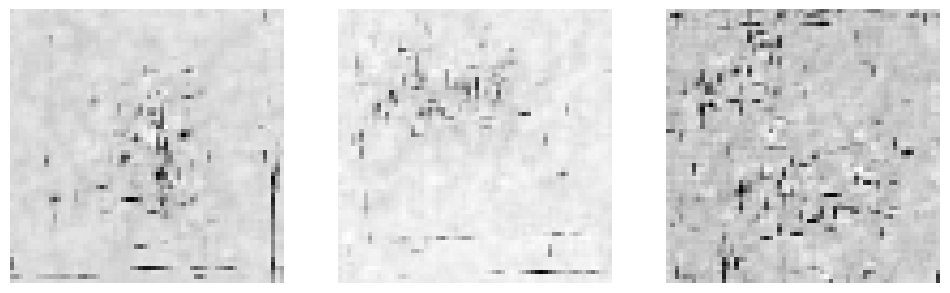

In [94]:
import torch

# Function to generate new images
def generate_images(vae, num_images=10, latent_dim=10):
    # Set the model to evaluation mode
    vae.eval()
    
    # Sample from a standard normal distribution
    z = torch.randn(num_images, latent_dim).to(device)  # Ensure z is on the correct device
    
    with torch.no_grad():  # Disable gradient calculations
        generated_images = vae.decoder(z)  # Use the decoder to generate images

    return generated_images

# Load the saved model
latent_dim = 10  # Use the same latent_dim you used for training
vae = VAE(latent_dim).to(device)
vae.load_state_dict(torch.load('vae_model.pth'))  # Load the model weights

# Generate new images
num_images_to_generate = 3
generated_images = generate_images(vae, num_images_to_generate, latent_dim)

# Function to display the generated images
def show_generated_images(images):
    # Convert images to numpy for visualization
    import matplotlib.pyplot as plt
    
    images = images.cpu().numpy()  # Move to CPU and convert to numpy
    images = images.squeeze()  # Remove channel dimension if necessary

    plt.figure(figsize=(12, 4))
    for i in range(len(images)):
        plt.subplot(1, len(images), i + 1)
        plt.imshow(images[i], cmap='gray')  # Use appropriate colormap
        plt.axis('off')
    plt.show()

# Display the generated images
show_generated_images(generated_images)

In [97]:
# Use the Kaggle API to download the model
!cp vae_model.pth /kaggle/working/

cp: 'vae_model.pth' and '/kaggle/working/vae_model.pth' are the same file


In [100]:
import torch
from IPython.display import FileLink

# Save the model's state_dict
model_save_path = "vae_model.pth"
torch.save(vae.state_dict(), model_save_path)
print(f"Model saved to {model_save_path}")

# Provide a link to download the model file
download_link = FileLink(model_save_path)
download_link

Model saved to vae_model.pth


/kaggle/working/vae_model.pth

In [ ]:
import shutil
import os

# Path to the segmented_signatures folder
segmented_signatures_folder = '/kaggle/working/augmented_signatures'

# Check if the folder exists
if os.path.exists(segmented_signatures_folder):
    # Delete the folder and all its contents
    shutil.rmtree(segmented_signatures_folder)
    print(f"Deleted folder: {segmented_signatures_folder}")
else:
    print(f"Folder not found: {segmented_signatures_folder}")

In [9]:
#GANS

In [10]:
import torch
from torch.utils.data import DataLoader, TensorDataset

# Convert images to a PyTorch Tensor
images_tensor = torch.Tensor(images)

# Create a DataLoader
batch_size = 64
dataset = TensorDataset(images_tensor)
train_loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

In [11]:
import torch.nn as nn

class Generator(nn.Module):
    def __init__(self, latent_dim):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(latent_dim, 128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(128, 256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 64 * 64),
            nn.Tanh()  # Output range of [-1, 1]
        )

    def forward(self, z):
        img = self.model(z)
        img = img.view(img.size(0), 1, 64, 64)  # Reshape to image format
        return img
    
    
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(64 * 64, 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(256, 1),
            nn.Sigmoid()  # Output probability (real or fake)
        )

    def forward(self, img):
        img_flat = img.view(img.size(0), -1)  # Flatten the image
        validity = self.model(img_flat)
        return validity

In [12]:
# Hyperparameters
latent_dim = 100  # Dimensionality of the noise input
lr = 0.0002
beta1 = 0.5
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Initialize Generator and Discriminator
generator = Generator(latent_dim).to(device)
discriminator = Discriminator().to(device)

# Loss function
adversarial_loss = nn.BCELoss()

# Optimizers
optimizer_G = torch.optim.Adam(generator.parameters(), lr=lr, betas=(beta1, 0.999))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(beta1, 0.999))

In [17]:
num_epochs = 5000
real_label = 1
fake_label = 0

for epoch in range(num_epochs):
    for i, (real_images,) in enumerate(train_loader):
        
        # Move real images to device
        real_images = real_images.to(device)
        
        # -----------------
        # Train Discriminator
        # -----------------
        optimizer_D.zero_grad()

        # Generate fake images
        z = torch.randn(batch_size, latent_dim).to(device)
        fake_images = generator(z)

        # Real images label = 1, fake images label = 0
        real_validity = discriminator(real_images)
        fake_validity = discriminator(fake_images.detach())
        
        real_loss = adversarial_loss(real_validity, torch.ones_like(real_validity).to(device))
        fake_loss = adversarial_loss(fake_validity, torch.zeros_like(fake_validity).to(device))
        
        # Total loss for discriminator
        d_loss = (real_loss + fake_loss) / 2
        d_loss.backward()
        optimizer_D.step()

        # -----------------
        # Train Generator
        # -----------------
        optimizer_G.zero_grad()

        # Generator tries to fool discriminator
        validity = discriminator(fake_images)
        g_loss = adversarial_loss(validity, torch.ones_like(validity).to(device))

        g_loss.backward()
        optimizer_G.step()

    print(f"Epoch [{epoch+1}/{num_epochs}] | D Loss: {d_loss.item():.4f} | G Loss: {g_loss.item():.4f}")

print("Training complete!")

Epoch [1/5000] | D Loss: 0.6985 | G Loss: 0.6920
Epoch [2/5000] | D Loss: 0.6927 | G Loss: 0.6796
Epoch [3/5000] | D Loss: 0.6888 | G Loss: 0.7010
Epoch [4/5000] | D Loss: 0.6898 | G Loss: 0.6897
Epoch [5/5000] | D Loss: 0.6923 | G Loss: 0.6890
Epoch [6/5000] | D Loss: 0.6931 | G Loss: 0.6936
Epoch [7/5000] | D Loss: 0.6935 | G Loss: 0.6819
Epoch [8/5000] | D Loss: 0.6923 | G Loss: 0.6921
Epoch [9/5000] | D Loss: 0.6932 | G Loss: 0.7013
Epoch [10/5000] | D Loss: 0.6933 | G Loss: 0.6972
Epoch [11/5000] | D Loss: 0.6932 | G Loss: 0.6934
Epoch [12/5000] | D Loss: 0.6936 | G Loss: 0.6919
Epoch [13/5000] | D Loss: 0.6918 | G Loss: 0.7155
Epoch [14/5000] | D Loss: 0.6930 | G Loss: 0.7024
Epoch [15/5000] | D Loss: 0.6941 | G Loss: 0.6999
Epoch [16/5000] | D Loss: 0.6949 | G Loss: 0.6986
Epoch [17/5000] | D Loss: 0.6956 | G Loss: 0.7100
Epoch [18/5000] | D Loss: 0.6987 | G Loss: 0.6820
Epoch [19/5000] | D Loss: 0.7041 | G Loss: 0.6602
Epoch [20/5000] | D Loss: 0.6934 | G Loss: 0.6351
Epoch [21

In [20]:
# Save the trained generator and discriminator models
torch.save(generator.state_dict(), 'generator.pth')
torch.save(discriminator.state_dict(), 'discriminator.pth')

print("Models saved successfully!")

Models saved successfully!


In [23]:
from IPython.display import FileLink

# Create download links for the saved models
FileLink('generator.pth')  # For downloading the generator model
FileLink('discriminator.pth')  # For downloading the discriminator model

/kaggle/working/generator.pth

In [21]:
# Assuming the generator and discriminator models are already defined

# Load the trained generator and discriminator models
generator.load_state_dict(torch.load('generator.pth'))
discriminator.load_state_dict(torch.load('discriminator.pth'))

generator.eval()  # Set to evaluation mode
discriminator.eval()  # Set to evaluation mode

print("Models loaded successfully!")

Models loaded successfully!


/tmp/ipykernel_30/746513501.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load('generator.pth'))
/tmp/ipykernel_30/746513501.py:5: Futu

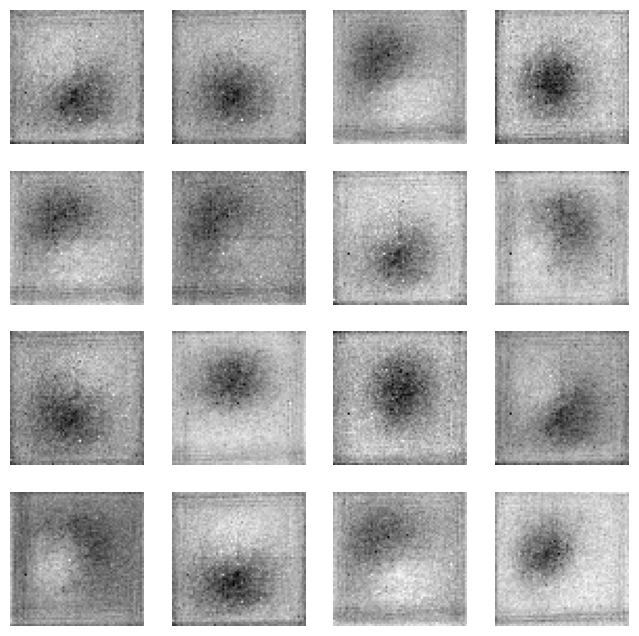

In [19]:
import matplotlib.pyplot as plt
import numpy as np

# Generate some images
z = torch.randn(16, latent_dim).to(device)  # 16 random noise vectors
generated_images = generator(z)

# Move to CPU and convert to numpy for visualization
generated_images = generated_images.cpu().detach().numpy()

# Plot the generated images
fig, axes = plt.subplots(4, 4, figsize=(8, 8))
for i, ax in enumerate(axes.flatten()):
    ax.imshow(generated_images[i].reshape(64, 64), cmap='gray')
    ax.axis('off')

plt.show()